Found 59 images.

0: 1280x960 1 plates, 66.5ms
Speed: 20.5ms preprocess, 66.5ms inference, 2.0ms postprocess per image at shape (1, 3, 1280, 960)

0: 1280x960 1 plates, 9.7ms
Speed: 7.0ms preprocess, 9.7ms inference, 1.4ms postprocess per image at shape (1, 3, 1280, 960)

0: 960x1280 1 plates, 10.4ms
Speed: 6.4ms preprocess, 10.4ms inference, 1.3ms postprocess per image at shape (1, 3, 960, 1280)

0: 960x1280 1 plates, 9.8ms
Speed: 6.1ms preprocess, 9.8ms inference, 1.4ms postprocess per image at shape (1, 3, 960, 1280)

0: 1280x960 1 plates, 10.4ms
Speed: 6.3ms preprocess, 10.4ms inference, 1.6ms postprocess per image at shape (1, 3, 1280, 960)

0: 1280x960 1 plates, 9.8ms
Speed: 6.9ms preprocess, 9.8ms inference, 1.6ms postprocess per image at shape (1, 3, 1280, 960)

0: 1280x1280 1 plates, 12.9ms
Speed: 7.9ms preprocess, 12.9ms inference, 1.4ms postprocess per image at shape (1, 3, 1280, 1280)

0: 960x1280 2 platess, 10.2ms
Speed: 6.0ms preprocess, 10.2ms inference, 2.7ms postproces

C:\Users\hengz\AppData\Local\Temp\ipykernel_40260\1958166596.py:111: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  fig.subplots_adjust(wspace=0.02)


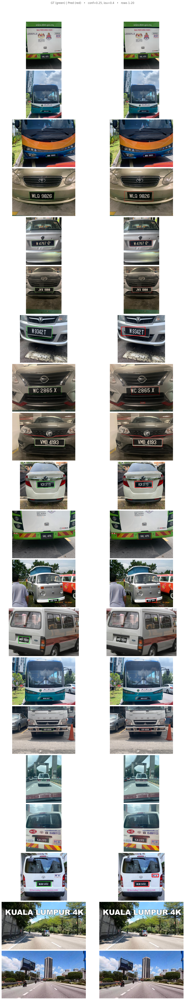


0: 736x1280 1 plates, 291.7ms
Speed: 11.4ms preprocess, 291.7ms inference, 1.5ms postprocess per image at shape (1, 3, 736, 1280)

0: 736x1280 1 plates, 7.7ms
Speed: 5.9ms preprocess, 7.7ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 1280)

0: 736x1280 1 plates, 7.4ms
Speed: 5.2ms preprocess, 7.4ms inference, 1.3ms postprocess per image at shape (1, 3, 736, 1280)

0: 736x1280 1 plates, 7.4ms
Speed: 5.3ms preprocess, 7.4ms inference, 1.5ms postprocess per image at shape (1, 3, 736, 1280)

0: 736x1280 1 plates, 7.6ms
Speed: 5.2ms preprocess, 7.6ms inference, 1.6ms postprocess per image at shape (1, 3, 736, 1280)

0: 736x1280 1 plates, 7.6ms
Speed: 5.2ms preprocess, 7.6ms inference, 1.3ms postprocess per image at shape (1, 3, 736, 1280)

0: 736x1280 (no detections), 7.4ms
Speed: 5.4ms preprocess, 7.4ms inference, 0.4ms postprocess per image at shape (1, 3, 736, 1280)

0: 736x1280 1 plates, 7.6ms
Speed: 5.4ms preprocess, 7.6ms inference, 1.3ms postprocess per image at shap

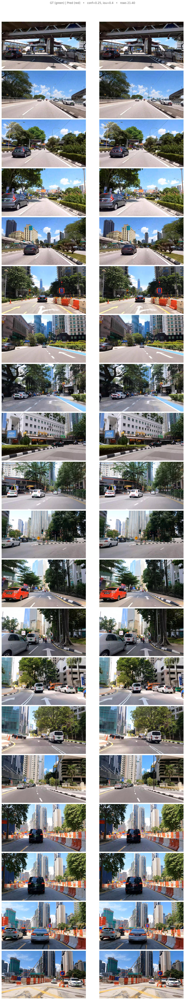


0: 736x1280 1 plates, 276.1ms
Speed: 13.7ms preprocess, 276.1ms inference, 1.7ms postprocess per image at shape (1, 3, 736, 1280)

0: 736x1280 3 platess, 7.5ms
Speed: 5.3ms preprocess, 7.5ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 1280)

0: 736x1280 2 platess, 7.8ms
Speed: 5.6ms preprocess, 7.8ms inference, 1.8ms postprocess per image at shape (1, 3, 736, 1280)

0: 736x1280 2 platess, 7.8ms
Speed: 5.3ms preprocess, 7.8ms inference, 2.0ms postprocess per image at shape (1, 3, 736, 1280)

0: 736x1280 1 plates, 7.7ms
Speed: 5.0ms preprocess, 7.7ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 1280)

0: 736x1280 3 platess, 7.7ms
Speed: 5.0ms preprocess, 7.7ms inference, 3.1ms postprocess per image at shape (1, 3, 736, 1280)

0: 736x1280 3 platess, 7.6ms
Speed: 5.8ms preprocess, 7.6ms inference, 2.4ms postprocess per image at shape (1, 3, 736, 1280)

0: 736x1280 2 platess, 7.7ms
Speed: 5.2ms preprocess, 7.7ms inference, 1.7ms postprocess per image at shape

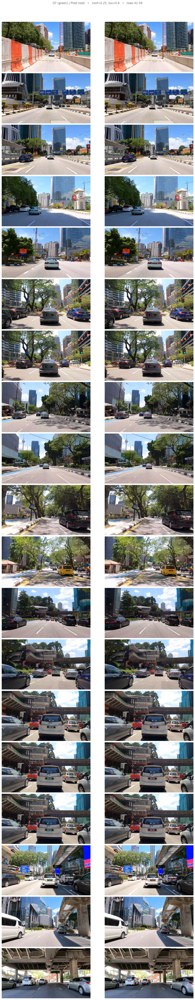

In [ ]:
# predict_and_plot_grid.py
from ultralytics import YOLO
import matplotlib.pyplot as plt
import cv2, os
from glob import glob

# ==================
# MODEL_PATH = "../runs/plates/v3_RainyKlNight_SupplimentaryMorning_TaxiEV/weights/best.pt"
# IMG_DIR    = "../dataset/V3_rainyKLnight_TaxiEV_SupplimentaryMoriningKL/valid/images/"

MODEL_PATH = "../runs/plates/v2_leegame_kl4k60fps/weights/best.pt"
IMG_DIR    = "../dataset/V2_leegame_kl4k60fps/valid/images/"

IMGSZ      = 1280
CONF       = 0.25
IOU_NMS    = 0.40

ROWS_PER_FIG = 20     # 每页显示多少行（每行=一张图：左GT右Pred）
LINE_W_GT    = 2     # GT 线宽
LINE_W_PRED  = 3     # Pred 线宽

def yolo_to_xyxy(line, W, H):
    parts = line.strip().split()
    if len(parts) != 5: return None, None
    cls = int(float(parts[0]))
    cx, cy, w, h = map(float, parts[1:])
    x1 = int((cx - w/2) * W); y1 = int((cy - h/2) * H)
    x2 = int((cx + w/2) * W); y2 = int((cy + h/2) * H)
    x1 = max(0, min(x1, W-1)); x2 = max(0, min(x2, W-1))
    y1 = max(0, min(y1, H-1)); y2 = max(0, min(y2, H-1))
    return cls, [x1, y1, x2, y2]

def load_gt(img_path):
    # 取出 images 根目录的根：.../valid/
    images_root = os.path.abspath(IMG_DIR)                    # .../valid/images/
    valid_root  = os.path.dirname(images_root)                # .../valid/
    labels_root = os.path.join(valid_root, "labels")          # .../valid/labels

    # 计算相对路径，然后把后缀改成 .txt
    rel = os.path.relpath(os.path.abspath(img_path), images_root)  # e.g. sub/a.jpg
    base, _ = os.path.splitext(rel)
    lbl_path = os.path.join(labels_root, base + ".txt")

    if not os.path.exists(lbl_path):
        # 帮你排查时看得到
        print(f"[GT] label missing: {lbl_path}")
        return []

    im = cv2.imread(img_path)
    H, W = im.shape[:2]
    out = []
    with open(lbl_path, "r", encoding="utf-8") as f:
        for line in f:
            cls, box = yolo_to_xyxy(line, W, H)
            if box is not None:
                out.append((cls, box))
    return out


def draw_boxes_only(img_bgr, boxes, color=(0,255,0), thickness=2):
    c = img_bgr.copy()
    for _, (x1,y1,x2,y2) in boxes:
        cv2.rectangle(c, (x1,y1), (x2,y2), color, thickness, cv2.LINE_AA)
    return c

if __name__ == "__main__":
    model = YOLO(MODEL_PATH)
    image_paths = sorted(glob(os.path.join(IMG_DIR, "*.jpg"))) + \
                  sorted(glob(os.path.join(IMG_DIR, "*.png")))
    print(f"Found {len(image_paths)} images.")

    # 逐页渲染（每页 ROWS_PER_FIG 行 × 2 列）
    for page_start in range(0, len(image_paths), ROWS_PER_FIG):
        page_paths = image_paths[page_start : page_start + ROWS_PER_FIG]
        n_rows = len(page_paths)

        fig, axes = plt.subplots(n_rows, 2, figsize=(12, 3*n_rows), constrained_layout=True)
        if n_rows == 1:
            axes = [axes]  # 统一成二维索引：axes[row][col]

        for row, img_path in enumerate(page_paths):
            img_bgr = cv2.imread(img_path)
            if img_bgr is None:
                # 占位空白，防止崩溃
                axes[row][0].axis("off")
                axes[row][1].axis("off")
                continue

            # GT（左列）
            gts = load_gt(img_path)
            gt_img = draw_boxes_only(img_bgr, gts, color=(0,200,0), thickness=LINE_W_GT)

            # Pred（右列）
            result = model.predict(img_bgr, imgsz=IMGSZ, conf=CONF, iou=IOU_NMS,
                                   save=False, show=False)[0]
            preds = []
            if result.boxes is not None and len(result.boxes) > 0:
                for i in range(len(result.boxes)):
                    x1,y1,x2,y2 = map(int, result.boxes.xyxy[i].tolist())
                    preds.append((0, [x1,y1,x2,y2]))  # 仅画框
            pred_img = draw_boxes_only(img_bgr, preds, color=(0, 0, 255), thickness=LINE_W_PRED)

            # 画到 subplot：左 GT，右 Pred（都不显示文字）
            axes[row][0].imshow(cv2.cvtColor(gt_img, cv2.COLOR_BGR2RGB))
            axes[row][0].axis("off")
            axes[row][1].imshow(cv2.cvtColor(pred_img, cv2.COLOR_BGR2RGB))
            axes[row][1].axis("off")

       
        fig.subplots_adjust(wspace=0.02)  
        fig.suptitle(f"GT (green) | Pred (red)   •   conf={CONF}, iou={IOU_NMS}   •   rows {page_start+1}-{page_start+n_rows}",
                     fontsize=12, y=1.02, color="#666")
        plt.show()


In [ ]:
YOLO.val()